# Рынок заведений общественного питания Москвы

**ОГЛАВЛЕНИЕ**

- [ОПИСАНИЕ ПРОЕКТА](#description)

- [ЦЕЛЬ ПРОЕКТА](#purpose)

- [ОПИСАНИЕ ДАННЫХ](#data)

1. [Изучим общую информацию о данных](#info)
 
   [Вывод по разделу №1](#conclusion_1)
   
2. [Проведем предобработку данных](#preprocessing)

   [Вывод по разделу №2](#conclusion_2)
   
3. [Проведем исследовательский анализ данных](#analysis)

     3.1. [Анализ количества объектов общественного питания по категориям](#analysis_1)
   
     3.2. [Анализ числа посадочных мест объектов общественного питания по категориям](#analysis_2)

     3.3. [Исследуем соотношение сетевых и несетевых заведений в датасете](#analysis_3)

     3.4. [Проанализируем, какие категории объектов общественного питания чаще всего являются сетевыми](#analysis_4)

     3.5. [Определим топ-15 популярных сетей в Москве.](#analysis_5)

     3.6. [Определим общее количество заведений и количество заведений каждой категории по районам.](#analysis_6)

     3.7. [Визуализируем распределение средних рейтингов по категориям заведений.](#analysis_7)

     3.8. [Построим фоновую картограмму (хороплет) со средним рейтингом заведений каждого района.](#analysis_8)

     3.9. [Отобразим все заведения датасета на карте с помощью кластеров](#analysis_9)
     
     3.10. [Определим топ-15 улиц по количеству заведений в Москве](#analysis_10)
   
     3.11. [Найдем улицы, на которых находится только один объект общепита](#analysis_11)

     3.12. [Построим фоновую картограмму (хороплет) с медианными значениями стоимости заказов в рублях для каждого района.](#analysis_12)

    [Вывод по разделу №3](#conclusion_3)   
   
4. [Проведем детальный анализ на предмет возможного инвестирования в открытие кофейни.](#coffee)
   
     4.1. [Определим количество кофеен в датасете, в каких районах их больше всего, каковы особенности их расположения.](#coffee_1)
   
     4.2. [Определим количество круглосуточных кофеен.](#coffee_2)

     4.3. [Построим фоновую картограмму (хороплет) со средним рейтингом кофеен для каждого района.](#coffee_3)

     4.4. [Построим фоновую картограмму (хороплет) со средней стоимостью чашки капучино для каждого района г.Москва.](#coffee_4)

     [Вывод по разделу №4](#conclusion_4)
   
5. [РЕКОМЕНДАЦИИ.](#the_final) 

<a id="description"></a>

**ОПИСАНИЕ ПРОЕКТА**

Инвесторы из фонда «Shut Up and Take My Money» решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.

<a id="purpose"></a>

**ЦЕЛЬ ПРОЕКТА**

1. Подготовить исследование рынка общественного питания г. Москва.
2. Провести исследовательский анализ заведений общественного питания по различным параметрам.
3. На основании проведенного анализа сделать выводы.
4. Провести более детальный анализ на предмет возможного инвестирования в открытие кофейни.
5. Подготовить презентацию проведенного исследования со своими рекомендациями на предмет открытия заведения.


<a id="data"></a>

**ОПИСАНИЕ ДАННЫХ**

**Файлы**
- `moscow_places.csv` — датасет, который хранит информацию данные о заведениях общественного питания Москвы.

- `admin_level_geomap.geojson` —  границы районов Москвы, которые встречаются в датасете `moscow_places.csv`.


**Структура moscow_places.csv:**
    
`name` — название заведения;

`address` — адрес заведения;

`category` — категория заведения, например «кафе», «пиццерия» или «кофейня»;

`hours` — информация о днях и часах работы;

`lat` — широта географической точки, в которой находится заведение;

`lng` — долгота географической точки, в которой находится заведение;

`rating` — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);

`price` — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;

`avg_bill` — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
- «Средний счёт: 1000–1500 ₽»;
- «Цена чашки капучино: 130–220 ₽»;
- «Цена бокала пива: 400–600 ₽».
- и так далее;

`middle_avg_bill` — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
- Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
- Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
- Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.

`middle_coffee_cup` — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
- Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
- Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
- Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.

`chain` — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):
- 0 — заведение не является сетевым
- 1 — заведение является сетевым

`district` — административный район, в котором находится заведение, например Центральный административный округ;

`seats` — количество посадочных мест.

<a id="info"></a>

## Изучим общую информацию о данных

**Импортируем необходимые для работы над проектом библиотеки.**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly import graph_objects as go
import folium as f # импортируем геокарты 
from folium.plugins import MarkerCluster # импортируем карту и маркер
from folium.features import CustomIcon # импортируем собственные иконки
import json # подключаем модуль для работы с JSON-форматом
import warnings
warnings.simplefilter('ignore')
pd.set_option('display.max_colwidth', None)
pd.set_option("display.max_rows", None)

**Считаем данные из csv-файла в датафрейм, сохраним в переменную `data`.**

In [2]:
path = 'D://WinUsers//Lenovo//Desktop//ПРОЕКТНЫЕ ФАЙЛЫ.CSV//Проект_7//' 

data = pd.read_csv(path + 'moscow_places.csv')

**Напишем функцию `data_analysis()` для обзора и анализа данных.**

In [3]:
def data_analysis(df):
    display (df.head())
    print('*'*80),
    df.info()
    print('*'*80)
    display (df.describe())
    print('*'*80),
    display (df.describe (include='object'))
    print('*'*80)
    print(f'Количество уникальных значений по столбцам датафрейма:\n{df.nunique()}') #display (df.nunique())
    print('*'*80)
    print(f'Пропущенные значения во всех столбцах датафрейма:\n{df.isna().sum()}')
    print('*'*80)
    print(f'Количество явных дубликатов: {df.duplicated().sum()}')
    print(f'Доля явных дубликатов от общего количества данных:'
          f'{(round(df.duplicated().sum() / len(df), 4)):.2%}')

**Проанализируем данные о заказах в датафрейме `data`.**

In [4]:
data_analysis(data)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


********************************************************************************
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memo

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,8406.000000,8406.000000,8406.000000,3149.000000,535.000000,8406.000000,4795.000000
mean,55.750109,37.608570,4.229895,958.053668,174.721495,0.381275,108.421689
std,0.069658,0.098597,0.470348,1009.732845,88.951103,0.485729,122.833396
min,55.573942,37.355651,1.000000,0.000000,60.000000,0.000000,0.000000
25%,55.705155,37.538583,4.100000,375.000000,124.500000,0.000000,40.000000
50%,55.753425,37.605246,4.300000,750.000000,169.000000,0.000000,75.000000
75%,55.795041,37.664792,4.400000,1250.000000,225.000000,1.000000,140.000000
max,55.928943,37.874466,5.000000,35000.000000,1568.000000,1.000000,1288.000000


********************************************************************************


,name,category,address,district,hours,price,avg_bill
count,8406,8406,8406,8406,7870,3315,3816
unique,5614,8,5753,9,1307,4,897
top,Кафе,кафе,"Москва, проспект Вернадского, 86В",Центральный административный округ,"ежедневно, 10:00–22:00",средние,Средний счёт:1000–1500 ₽
freq,189,2378,28,2242,759,2117,241


********************************************************************************
Количество уникальных значений по столбцам датафрейма:
name                 5614
category                8
address              5753
district                9
hours                1307
lat                  8209
lng                  8258
rating                 41
price                   4
avg_bill              897
middle_avg_bill       230
middle_coffee_cup      96
chain                   2
seats                 229
dtype: int64
********************************************************************************
Пропущенные значения во всех столбцах датафрейма:
name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats             

In [5]:
print(f'Количество категорий общественного питания: {data.category.nunique()}')
print(f'Название категорий общественного питания: {data.category.unique()}')

Количество категорий общественного питания: 8
Название категорий общественного питания: ['кафе' 'ресторан' 'кофейня' 'пиццерия' 'бар,паб' 'быстрое питание'
 'булочная' 'столовая']


In [6]:
data.category.value_counts()

category
кафе               2378
ресторан           2043
кофейня            1413
бар,паб             765
пиццерия            633
быстрое питание     603
столовая            315
булочная            256
Name: count, dtype: int64

<a id="conclusion_1"></a>
<div style="background:#00FA9A; color:#000080; padding:10px">
  <b>Вывод по разделу №1:</b>
   
***Проанализировали общую информацию о датафрейме `data`:***   

- Всего в датасете 8 406 строк;
  
- Тип данных в во всех столбцах датасета корректен;

- Количество уникальных названий заведений общественного питания - `5 614 ед.`  
- Категорий заведений общественного питания, которые представлены в датасете - `8`. Наиболее часто встречающееся `кафе`;
  
- Явные дубликаты отсутствуют;

- Большое количество пропущенных значений в столбцах - `hours`, `price`, `avg_bill`, `middle_avg_bill`, `middle_coffee_cup`, `seats`- предположу, что это связано в большей степени с отсутствием информации от владельцев

- Данные признаны достаточными для исследования.
    
</div>

<a id="preprocessing"></a>

## Проведем предобработку данных

**Приведем названия столбцов датафрейма `data` к нижнему регистру и заменим `ё` на `e`.**

In [7]:
for i in ['name', 'address', 'avg_bill']:
    data[i] = data[i].str.lower()
    data[i] = data[i].str.replace('ё','е')
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,средний счет:1500–1600 ₽,1550.0,NaN,0,4.0
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,средний счет:от 1000 ₽,1000.0,NaN,0,45.0
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,средний счет:400–600 ₽,500.0,NaN,1,148.0


**Проверим датафрейм `data` на неявные дубликаты по столбцам `name` и `address`.**

In [8]:
data.duplicated(subset=['name', 'address']).sum()

4

**Удалим неявные дубликаты по столбцам `name` на `address`.**

In [9]:
data = data.drop_duplicates(subset=['name', 'address'])
len(data)

8402

**Заполнять пропуски в столбцах средним или медианой считаю некоректным. Поэтому в столбцах типа `object` на пропуски поставим заглушку `no_data`. В столбцах типа `float64` поставим заглушку `-1`.**

In [10]:
for o in ['price', 'avg_bill']:
    data[i] = data[i].fillna('no_data')
for i in ['middle_avg_bill', 'middle_coffee_cup', 'seats']:
    data[i] = data[i].fillna(-1)
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,no_data,-1.0,-1.0,0,-1.0
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,средний счет:1500–1600 ₽,1550.0,-1.0,0,4.0
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,средний счет:от 1000 ₽,1000.0,-1.0,0,45.0
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,цена чашки капучино:155–185 ₽,-1.0,170.0,0,-1.0
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,средний счет:400–600 ₽,500.0,-1.0,1,148.0


**Посмотрим на написание адресов столбца `address`.**

In [11]:
data.address.value_counts()

address
москва, проспект вернадского, 86в                                                                                                 28
москва, усачева улица, 26                                                                                                         26
москва, площадь киевского вокзала, 2                                                                                              20
москва, ярцевская улица, 19                                                                                                       19
москва, каширское шоссе, 61г                                                                                                      16
москва, щелковское шоссе, вл75                                                                                                    16
москва, проспект мира, 211к2                                                                                                      16
москва, лесная улица, 20, стр. 3                             

**Создадим отдельный столбец с названиями улиц `street`.**

In [12]:
data['street'] = data['address'].str.split(',').str[1]
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,no_data,-1.0,-1.0,0,-1.0,улица дыбенко
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,средний счет:1500–1600 ₽,1550.0,-1.0,0,4.0,улица дыбенко
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,средний счет:от 1000 ₽,1000.0,-1.0,0,45.0,клязьминская улица
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,цена чашки капучино:155–185 ₽,-1.0,170.0,0,-1.0,улица маршала федоренко
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,средний счет:400–600 ₽,500.0,-1.0,1,148.0,правобережная улица


**Посмотрим на написание часов работы заведений столбца `hours`.**

In [13]:
data.hours.value_counts()

hours
ежедневно, 10:00–22:00                                                                               758
ежедневно, круглосуточно                                                                             730
ежедневно, 11:00–23:00                                                                               396
ежедневно, 10:00–23:00                                                                               310
ежедневно, 12:00–00:00                                                                               254
ежедневно, 09:00–21:00                                                                               204
ежедневно, 09:00–22:00                                                                               184
ежедневно, 12:00–23:00                                                                               178
ежедневно, 08:00–23:00                                                                               160
ежедневно, 08:00–22:00                           

**Создадим отдельный столбец со значением `is_24_7` со значением `True` - если заведение работает `24/7` и `False` если наоборот.**

In [14]:
data['is_24_7'] = data.hours.str.contains('ежедневно, круглосуточно')
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,no_data,-1.0,-1.0,0,-1.0,улица дыбенко,False
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,средний счет:1500–1600 ₽,1550.0,-1.0,0,4.0,улица дыбенко,False
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,средний счет:от 1000 ₽,1000.0,-1.0,0,45.0,клязьминская улица,False
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,цена чашки капучино:155–185 ₽,-1.0,170.0,0,-1.0,улица маршала федоренко,False
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,средний счет:400–600 ₽,500.0,-1.0,1,148.0,правобережная улица,False


**Изучим столбец `chain` по значению `0 ` - `несетевое`.**

In [15]:
data.query('chain == 0').name.value_counts()

name
кафе                                                                  188
шаурма                                                                 43
ресторан                                                               34
столовая                                                               28
кофейня                                                                12
бистро                                                                 12
кафе-столовая                                                           9
буфет                                                                   8
трапезная                                                               7
шашлычная                                                               6
поминальные обеды                                                       5
блины                                                                   3
пиццерия                                                                3
ням-ням                          

<div style="background:#AFEEEE; color:#000080; padding:10px">
 
После изучения данных столбца `chain` видно, что скорее всего судя по названиям мы имеем порядка 40-45 микросетей (по 2 единицы). Но думается, что относит их к `сетевым` все-таки будет неверно.

</div>

**Для улучшения дальнейших визулизаций заменим в столбце `chain` значения `0 и 1` на `несетевое и сетевое`.**

In [16]:
replace_chain = {0: 'несетевое', 1: 'сетевое'}
data.chain = data.chain.map(replace_chain)

**Изучим столбец `seats`.**

In [17]:
data[['name', 'category', 'address', 'seats']].sort_values(by='seats', ascending=False)

,name,category,address,seats
6684,пивной ресторан,"бар,паб","москва, проспект вернадского, 121, корп. 1",1288.0
6771,точка,кафе,"москва, проспект вернадского, 84, стр. 1",1288.0
6658,гудбар,"бар,паб","москва, проспект вернадского, 97, корп. 1",1288.0
6690,японская кухня,ресторан,"москва, проспект вернадского, 121, корп. 1",1288.0
6641,one price coffee,кофейня,"москва, проспект вернадского, 84, стр. 1",1288.0
6838,alternative coffee,кофейня,"москва, проспект вернадского, 41, стр. 1",1288.0
6574,мюнгер,пиццерия,"москва, проспект вернадского, 97, корп. 1",1288.0
6524,ян примус,ресторан,"москва, проспект вернадского, 121, корп. 1",1288.0
6518,delonixcafe,ресторан,"москва, проспект вернадского, 94, корп. 1",1288.0
6808,яндекс лавка,ресторан,"москва, проспект вернадского, 51, стр. 1",1288.0


<div style="background:#AFEEEE; color:#000080; padding:10px">
 
После изучения данных столбца `seats`обнаружены данные явно ошибочные. Построим `boxplot` и определимся с аномальными значениями.

</div>

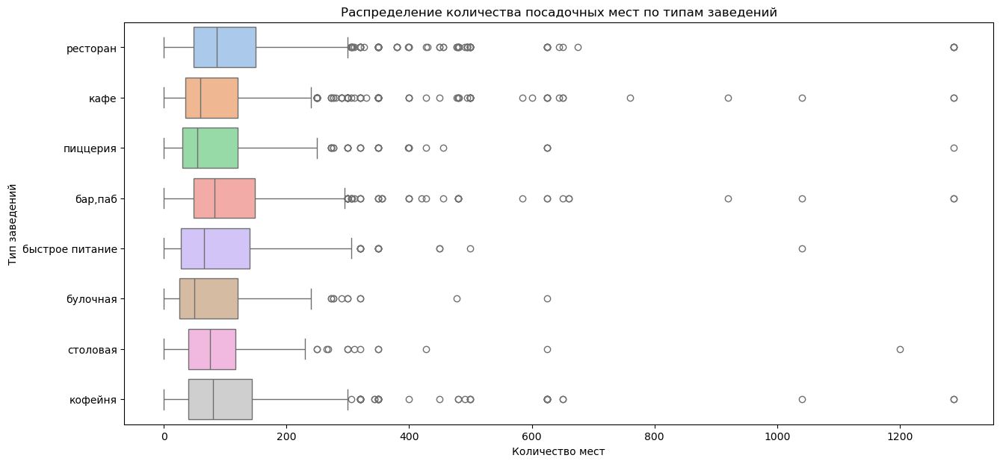

In [18]:
plt.figure(figsize=(15, 7))
ax = sns.boxplot(data = data.query('seats != -1'), x='seats', y='category', palette="pastel")
plt.title('Распределение количества посадочных мест по типам заведений')
plt.xlabel('Количество мест')
plt.ylabel('Тип заведений')
plt.show()

**Установим границу в 500 посадочных мест в столбце `seats`.**

In [19]:
print(f'Количество заведений с числом мест больше 500: {data.query('seats > 500')['name'].count()}')

#display(round(data.query('seats > 500')['name'].count() / len(data), 2):.2%)
print(f'Процент заведений с числом мест больше 500 от общего числа:'
     f'{(round(data.query('seats > 500')['name'].count() / len(data.query('seats != -1')), 4)):.2%}')

Количество заведений с числом мест больше 500: 56
Процент заведений с числом мест больше 500 от общего числа:1.17%


In [20]:
len(data.query('seats != -1'))

4792

In [21]:
data = data.query('seats <= 500')

In [22]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8346 entries, 0 to 8405
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8346 non-null   object 
 1   category           8346 non-null   object 
 2   address            8346 non-null   object 
 3   district           8346 non-null   object 
 4   hours              7818 non-null   object 
 5   lat                8346 non-null   float64
 6   lng                8346 non-null   float64
 7   rating             8346 non-null   float64
 8   price              3294 non-null   object 
 9   avg_bill           8346 non-null   object 
 10  middle_avg_bill    8346 non-null   float64
 11  middle_coffee_cup  8346 non-null   float64
 12  chain              8346 non-null   object 
 13  seats              8346 non-null   float64
 14  street             8346 non-null   object 
 15  is_24_7            7818 non-null   object 
dtypes: float64(6), object(10)
mem

<a id="conclusion_2"></a>
<div style="background:#00FA9A; color:#000080; padding:10px">
  <b>Вывод по разделу №2:</b>
   
***Провели предобработку данных датафрейма `data`:***
    
- Привели названия столбцов датафрейма к "правильному" стилю: нижний регистр и замена `ё` на `е`;
- Удалили неявные дубликаты по столбцам `name` и `address` - `4 шт.`;
- В столбцах типа `object` на пропуски данных поставили заглушку `no_data`, а в столбцах типа `float64` поставили заглушку `-1`;
- Создадили отдельные столбцы `is_24_7` (время работы: ежедневно, круглосуточно) и `street` (с названиями улиц);
- Для улучшения дальнейших визулизаций заменим в столбце `chain` значения `0 и 1` на `несетевое и сетевое`;
- Удалили аномальные значения из столбца `seats` (число посадочных мест в заведении);
- Приступим к исследовательскому анализу данных.
    
</div>

<a id="analysis"></a>

## Проведем исследовательский анализ данных

<a id="analysis_1"></a>

### Анализ количества объектов общественного питания по категориям.

In [23]:
data_all = data.pivot_table(index='category', values='name', aggfunc='count')\
               .sort_values(by='name', ascending=False)
data_all.style.background_gradient(cmap='coolwarm')

,name
category,
кафе,2362
ресторан,2030
кофейня,1401
"бар,паб",754
пиццерия,629
быстрое питание,602
столовая,313
булочная,255


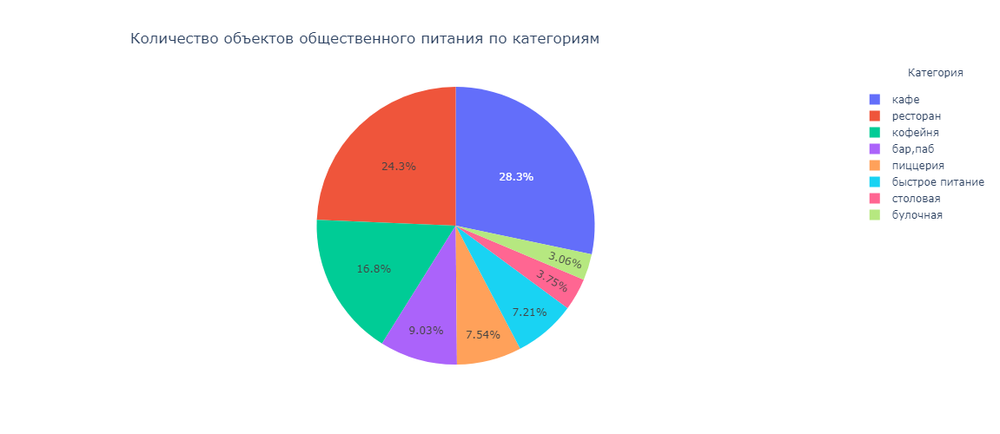

In [24]:
fig = go.Figure(data=[go.Pie(labels=data_all.index, values=data_all['name'])])
fig.update_layout(title_text='Количество объектов общественного питания по категориям', title_x=0.13,
                  width=950, 
                  height=500,
                  annotations=[dict(x=1.16, 
                                    y=1.08,
                                    text='Категория',
                                    showarrow=False)])


<div style="background:#AFEEEE; color:#000080; padding:10px">

- Наибольшую долю в общепите г. Москва занимают заведения категории `кафе` - `28.3% или 2 362 ед.`;
- Также в `топ-3` входят заведения категорий `ресторан` - `24.3% или 2 030 ед.` и `кофейня` - `16.8% или 1 401 ед.`;
- Примечательно, что на `топ-3` категорий приходится `69.4%` от общего количества заведений общественного питания.
</div>

<a id="analysis_2"></a>  

### Анализ числа посадочных мест объектов общественного питания по категориям.

     

In [25]:
data.query('seats != -1').groupby('category')['seats'].describe()

,count,mean,std,min,25%,50%,75%,max
category,,,,,,,,
"бар,паб",457.0,108.949672,93.282346,0.0,47.00,80.0,140.00,480.0
булочная,147.0,85.741497,87.347369,0.0,25.00,50.0,120.00,478.0
быстрое питание,348.0,96.186782,94.016352,0.0,27.25,65.0,136.25,500.0
кафе,1203.0,89.417290,88.808477,0.0,35.00,60.0,105.50,500.0
кофейня,739.0,100.433018,90.991761,0.0,40.00,78.0,140.00,500.0
пиццерия,423.0,87.912530,85.482541,0.0,30.00,52.0,120.00,455.0
ресторан,1257.0,114.904535,96.959619,0.0,48.00,86.0,150.00,500.0
столовая,162.0,89.716049,77.272324,0.0,40.00,75.0,115.00,428.0


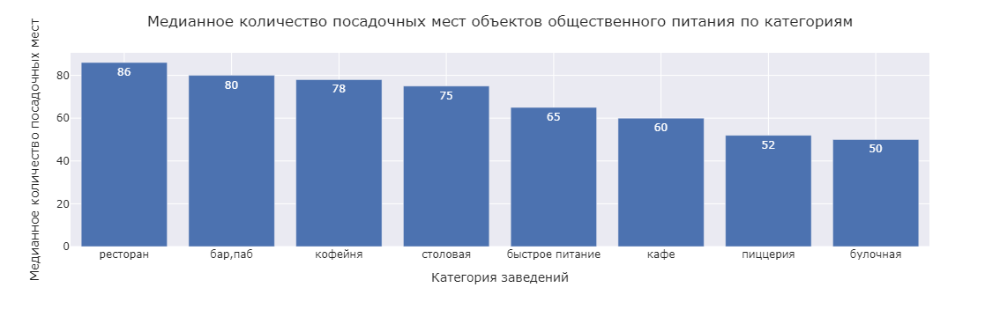

In [26]:
data_seats = data.query('seats != -1').groupby('category')['seats']\
                       .median().reset_index()\
                       .sort_values(by='seats', ascending=False)

fig = px.bar(data_seats, x = 'category', y = 'seats',
             text_auto = True, template='seaborn')
fig.update_layout(title = 'Медианное количество посадочных мест объектов общественного питания по категориям',
                 xaxis_title = 'Категория заведений',
                 yaxis_title = 'Медианное количество посадочных мест')
fig.show()


<div style="background:#AFEEEE; color:#000080; padding:10px">

- По медианному количеству посадочных мест в общепите г. Москва лидирующую позицию занимают заведения категории `ресторан` - `86 мест`;
- Немного уступают ресторанам заведения категорий `бар, паб` - `80 мест` и `кофейня` - `78 мест`;
- Наименьшее число посадочных мест предлагают заведения категории `булочная` - `50 мест`, что в принципе выглядит логичным исходя из формата заведения.

</div>

<a id="analysis_3"></a>

### Исследуем соотношение сетевых и несетевых заведений в датасете.

  

In [27]:
data_ch = data.pivot_table(index='chain', values='category', aggfunc='count')\
    .sort_values(by='category', ascending=False)
data_ch.style.background_gradient(cmap='coolwarm')

,category
chain,
несетевое,5169
сетевое,3177


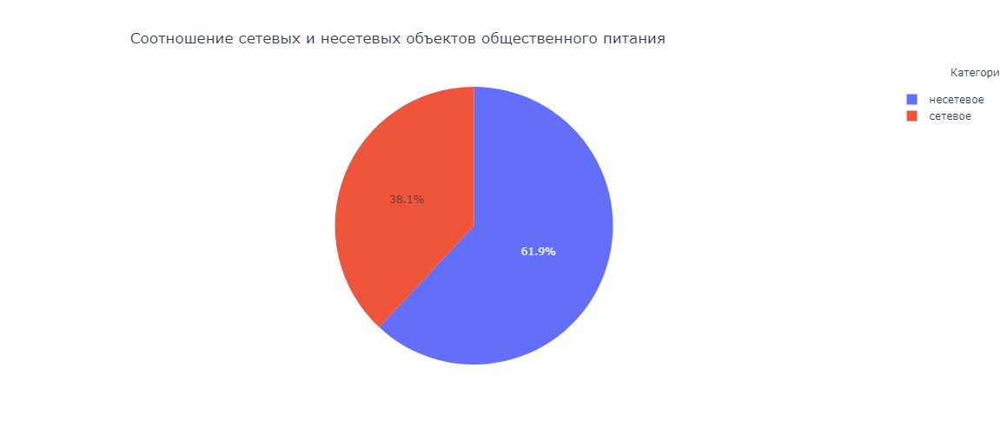

In [28]:
fig = go.Figure(data=[go.Pie(labels=data_ch.index, values=data_ch.category)])
fig.layout.template = 'plotly_white'
fig.update_layout(title_text='Соотношение сетевых и несетевых объектов общественного питания', 
                  title_x=0.13,
                  width=950, 
                  height=500,
                  annotations=[dict(x=1.16, 
                                    y=1.08,
                                    text='Категория',
                                    showarrow=False)])
fig.show() 

<div style="background:#AFEEEE; color:#000080; padding:10px">

- На основании проведенного анализа видно, что количество `несетевых заведений` общепита г. Москва составляет `61.9%`.

</div>

<a id="analysis_4"></a>

### Проанализируем, какие категории объектов общественного питания чаще всего являются сетевыми.

    

In [29]:
data.pivot_table(index='chain',
                 columns='category',
                 values='name',
                 aggfunc='count')\
                 .style.background_gradient(cmap='coolwarm')


category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
chain,,,,,,,,
несетевое,587,99,371,1588,688,301,1309,226
сетевое,167,156,231,774,713,328,721,87


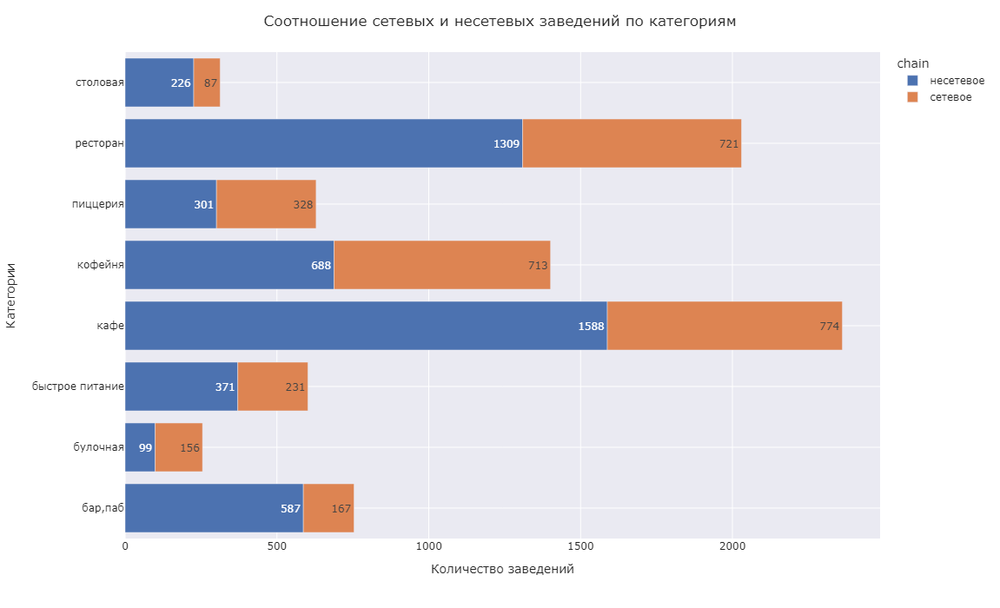

In [30]:
data_chain = data.groupby([ 'category', 'chain'])['name']\
                 .count().reset_index()
data_chain.columns = ['category', 'chain', 'count']
#chain_category = ['несетевые', 'сетевые']
fig = px.bar(data_chain,
             x='count',
             y='category',
             template='seaborn',                   
             color='chain',
             height=700,
             width=900, text_auto=True
                          )
fig.update_layout(title = 'Соотношение сетевых и несетевых заведений по категориям',
                 xaxis_title = 'Количество заведений',
                 yaxis_title = 'Категории'
                 )
fig.show()
         

<div style="background:#AFEEEE; color:#000080; padding:10px">

- В основном виден перевес `несетевых заведений` общепита;
- Лишь у 3-х категорий чуть больше `50% сетевых заведений`;
- Категория `пиццерия` соотношение сетевое/несетевое заведение `328 на 301`;
- Категория `кофейня` соотношение сетевое/несетевое заведение `713 на 688`;
- И у категории `булочная` доля сетевых заведений более `60%`- `156 на 99`.
</div>

<a id="analysis_5"></a>

### Определим топ-15 популярных сетей в Москве.



In [31]:
data_chain = data.query("chain == 'сетевое'")\
               .pivot_table(index=['name', 'category'], 
                            values='chain', 
                            aggfunc='count')\
                            .sort_values(by='chain',
                            ascending=False).reset_index()
data_chain.columns = ['name', 'category', 'count']
data_chain_top = data_chain.head(15)
data_chain_top.style.background_gradient(cmap='coolwarm')

,name,category,count
0,шоколадница,кофейня,117
1,домино'с пицца,пиццерия,76
2,додо пицца,пиццерия,74
3,one price coffee,кофейня,70
4,яндекс лавка,ресторан,68
5,cofix,кофейня,65
6,prime,ресторан,49
7,кофепорт,кофейня,42
8,кулинарная лавка братьев караваевых,кафе,38
9,теремок,ресторан,36


In [32]:
print(f'Количество сетевых заведений входящих в Топ-15: {data_chain_top['count'].sum()}')
print(f'Процент сетевых заведений входящих в Топ-15 от общего числа сетевых заведений:' 
      f'{(round(data_chain_top['count'].sum() / data_chain['count'].sum(), 4)):.2%}')


Количество сетевых заведений входящих в Топ-15: 763
Процент сетевых заведений входящих в Топ-15 от общего числа сетевых заведений:24.02%


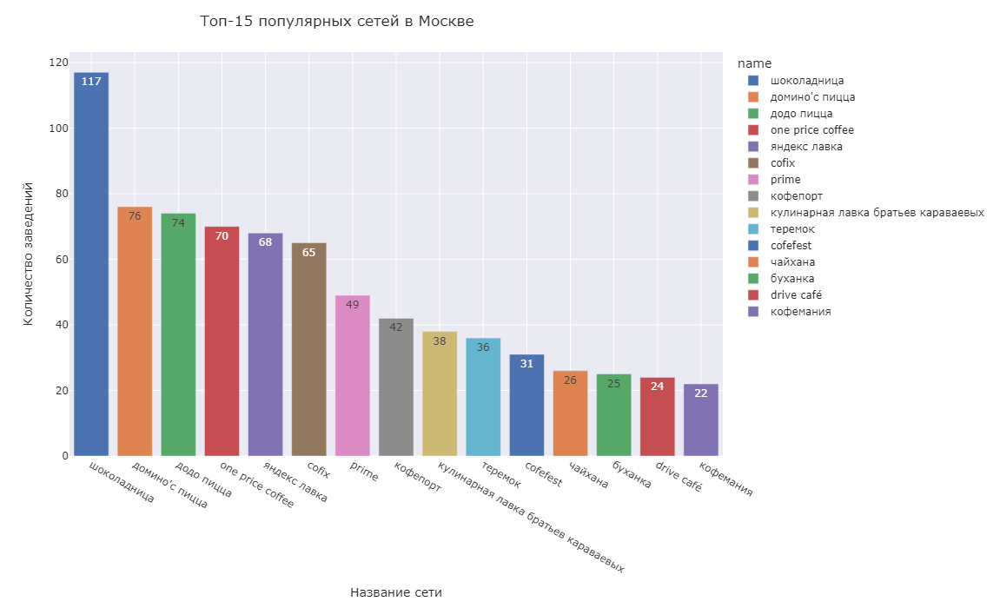

In [33]:
fig = px.bar(data_chain_top,
             x='name',
             y='count',
             template='seaborn',                   
             color='name',
             height=700,
             width=900, 
             text_auto=True
                          )
fig.update_layout(title = 'Топ-15 популярных сетей в Москве',
                  title_x=0.2,
                  xaxis_title = 'Название сети',
                  yaxis_title = 'Количество заведений')
fig.show()

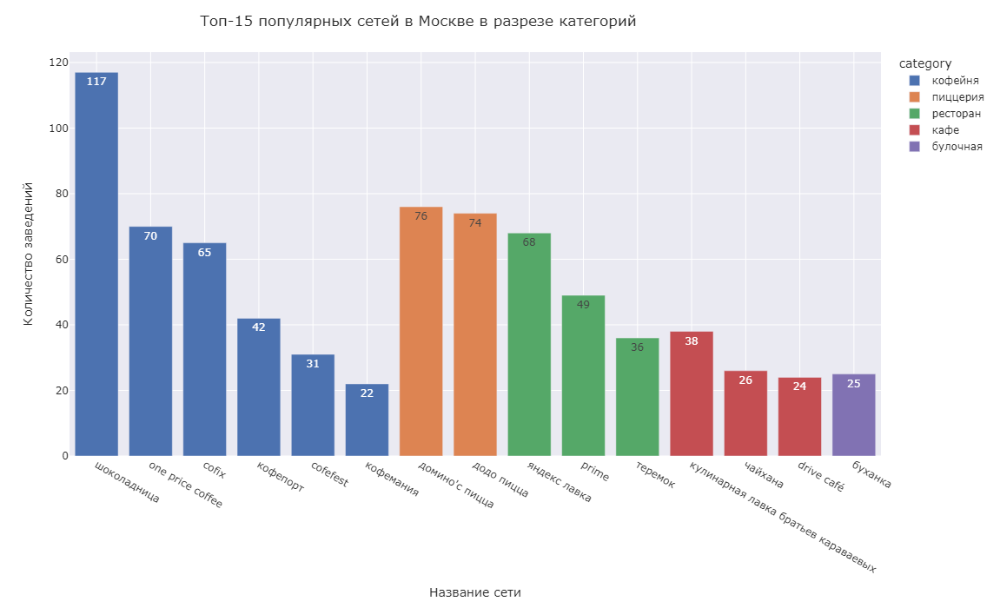

In [34]:
fig = px.bar(data_chain_top,
             x='name',
             y='count',
             template='seaborn',                   
             color='category',
            height=700,
             width=900, text_auto=True
                          )
fig.update_layout(title = 'Топ-15 популярных сетей в Москве в разрезе категорий',
                 title_x=0.2,
                 xaxis_title = 'Название сети',
                 yaxis_title = 'Количество заведений')
fig.show()

<div style="background:#AFEEEE; color:#000080; padding:10px">

- В `топ-15` `сетевых заведений` общепита вошли `кофейня` и `две пиццерии`;
- Самое большое сетевое заведение `кофейня Шоколадница` - `117 заведений`;
- Второе место `пиццерия Домино'c пицца` - `76 заведений` и третье `пиццерия Додо пицца` - `74 заведения`;
- Больше всего в `топ-15` вошло заведений из категории `кофейня` - `6 сетей`.
</div>

<a id="analysis_6"></a>


### Определим общее количество заведений и количество заведений каждой категории по районам.

  

In [35]:
data_district = data.pivot_table(index='district',
                                 columns='category',
                                 values='chain',
                                 aggfunc='count',
                                 margins=True).reset_index()
data_district

category,district,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая,All
0,Восточный административный округ,49,25,70,269,104,72,160,40,789
1,Западный административный округ,46,37,62,233,146,70,213,23,830
2,Северный административный округ,66,38,58,230,186,74,183,40,875
3,Северо-Восточный административный округ,62,28,82,269,159,68,182,40,890
4,Северо-Западный административный округ,23,12,30,115,62,40,109,18,409
5,Центральный административный округ,364,50,87,464,428,113,670,66,2242
6,Юго-Восточный административный округ,38,13,67,282,89,55,145,25,714
7,Юго-Западный административный округ,38,27,61,236,96,64,167,17,706
8,Южный административный округ,68,25,85,264,131,73,201,44,891
9,All,754,255,602,2362,1401,629,2030,313,8346


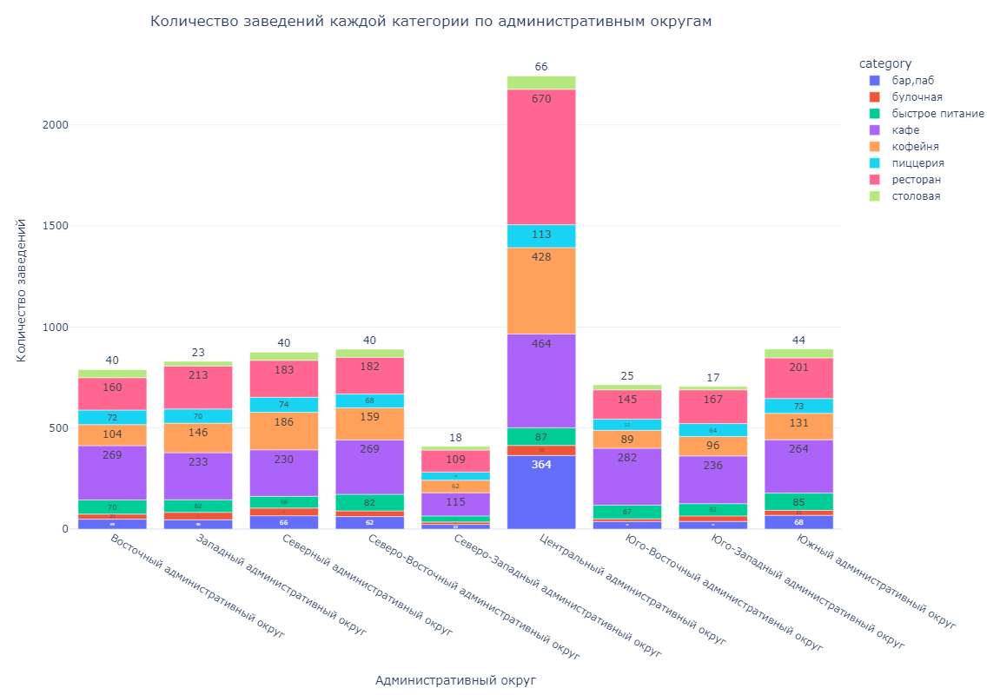

In [36]:
data_distr = data.groupby([ 'district', 'category'])['name']\
                 .count().reset_index()
data_distr.columns = ['district', 'category', 'count']
fig = px.bar(data_distr,
             x='district',
             y='count',
             template='plotly_white',                   
             color='category',
             height=800,
             width=1150, text_auto=True
                          )
#fig.update_traces(textposition = "outside")
fig.update_layout(title = 'Количество заведений каждой категории по административным округам',
                title_x=0.15,
                yaxis_title = 'Количество заведений',
                xaxis_title = 'Административный округ'
                 )
fig.show()

<div style="background:#AFEEEE; color:#000080; padding:10px">
    
- Всего в датасете представлено девять административных округов г. Москва;
- Четверть всех заведений общественного питания г. Москва сосредоточено в Центральном административном округе (ЦАО)  `2 242 заведения`, что неудивительно, так как активная общественная жизнь происходит в центре города;
- Также в ЦАО находится `треть всех ресторанов` столицы;
- Наименьшее количество заведений `875 заведений` находится в Северо-Западном округе г. Москва.
</div>

<a id="analysis_7"></a>

### Визуализируем распределение средних рейтингов по категориям заведений.

   

In [37]:
data_rating = data.pivot_table(index='category',
                               values='rating',
                               aggfunc='mean').round(2)\
                               .sort_values(by='rating', ascending=False)\
                               .reset_index()
data_rating.style.background_gradient(cmap='coolwarm')


,category,rating
0,"бар,паб",4.390000
1,пиццерия,4.300000
2,ресторан,4.290000
3,кофейня,4.280000
4,булочная,4.270000
5,столовая,4.210000
6,кафе,4.120000
7,быстрое питание,4.050000


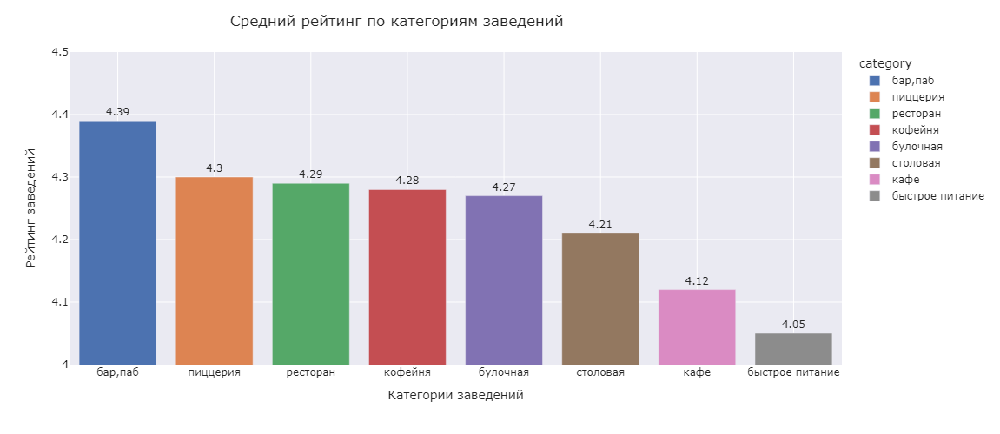

In [38]:
fig = px.bar(data_rating,
             x='category',
             y='rating',
             template='seaborn',                   
             color='category',
            height=500,
             width=900, text_auto=True
                          )
fig.update_traces(textposition = "outside")
fig.update_layout(yaxis_range=[4,4.5])
fig.update_layout(title = 'Средний рейтинг по категориям заведений',
                 title_x=0.23,
                 xaxis_title = 'Категории заведений',
                 yaxis_title = 'Рейтинг заведений')
fig.show()

<div style="background:#AFEEEE; color:#000080; padding:10px">
    
- Наивысший средний рейтинг у категории заведений `бар, паб - 4.39`;
- Далее примерно одинаковый рейтинг у заведений категорий `пиццерия - 4.3` и `ресторан - 4.29`;
- Наименьший средний рейтинг у категории заведений `быстрое питание - 4.05`;
- Стоит отметить, что по всем категориям средний рейтинг больше `4`, что является неплохим показателем.
</div>

<a id="analysis_8"></a>

### Построим фоновую картограмму (хороплет) со средним рейтингом заведений каждого района.

    

In [39]:
data_district_rating = data.pivot_table(index='district',
                                        values='rating',
                                        aggfunc='mean').round(2)\
                                        .sort_values(by='rating', ascending=False)\
                                        .reset_index()
data_district_rating.style.background_gradient(cmap='coolwarm')

,district,rating
0,Центральный административный округ,4.380000
1,Северный административный округ,4.240000
2,Северо-Западный административный округ,4.210000
3,Западный административный округ,4.180000
4,Южный административный округ,4.180000
5,Восточный административный округ,4.170000
6,Юго-Западный административный округ,4.170000
7,Северо-Восточный административный округ,4.150000
8,Юго-Восточный административный округ,4.100000


In [40]:
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = f.Map(location=[moscow_lat, moscow_lng], zoom_start=8, tiles='Cartodb Positron')
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
f.Choropleth(
    geo_data= state_geo,
    name='choropleth',
    data=data_district_rating,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGnBu',
    fill_opacity=0.8,
    legend_name='СРЕДНИЙ РЕЙТИНГ ЗАВЕДЕНИЙ ПО РАЙОНАМ Г. МОСКВА',
).add_to(m)
m

<div style="background:#AFEEEE; color:#000080; padding:10px">
    
- Наивысший средний рейтинг у заведений общепита `Центрального административного округа - 4.38`;
- Наименьший средний рейтинг у заведений общепита `Юго-Восточного административного округа - 4.10`;
- В остальных округах средний рейтинг варьируется в дипазоне `4.15 - 4.24`.
</div>

<a id="analysis_9"></a>

### Отобразим все заведения датасета на карте с помощью кластеров.

 

In [41]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = f.Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# функция, принимающая строку датафрейма, создает маркер в текущей точке и
# добавляет его в кластер marker_cluster

def create_cluster(row):
    f.Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)
    
# к каждой строке датафрейма применяем функцию
data.apply(create_cluster, axis=1)

# выводим карту
m

<div style="background:#AFEEEE; color:#000080; padding:10px">
    
- По карте с кластерами видно, что большинство заведений общепита расположено в `центре`, меньше всего расположено на `юге`;
  
</div>

<a id="analysis_10"></a>

### Определим топ-15 улиц по количеству заведений в Москве.



In [42]:
data_top_street = data.pivot_table(index='street',
                                   values='name',
                                   aggfunc='count')\
                                   .sort_values(by='name', ascending=False)\
                                   .head(15).reset_index()
data_top_street.columns = ['street', 'count']
data_top_street.style.background_gradient(cmap='coolwarm')

,street,count
0,проспект мира,183
1,профсоюзная улица,122
2,ленинский проспект,107
3,проспект вернадского,97
4,дмитровское шоссе,88
5,каширское шоссе,77
6,варшавское шоссе,76
7,ленинградский проспект,72
8,ленинградское шоссе,70
9,мкад,65


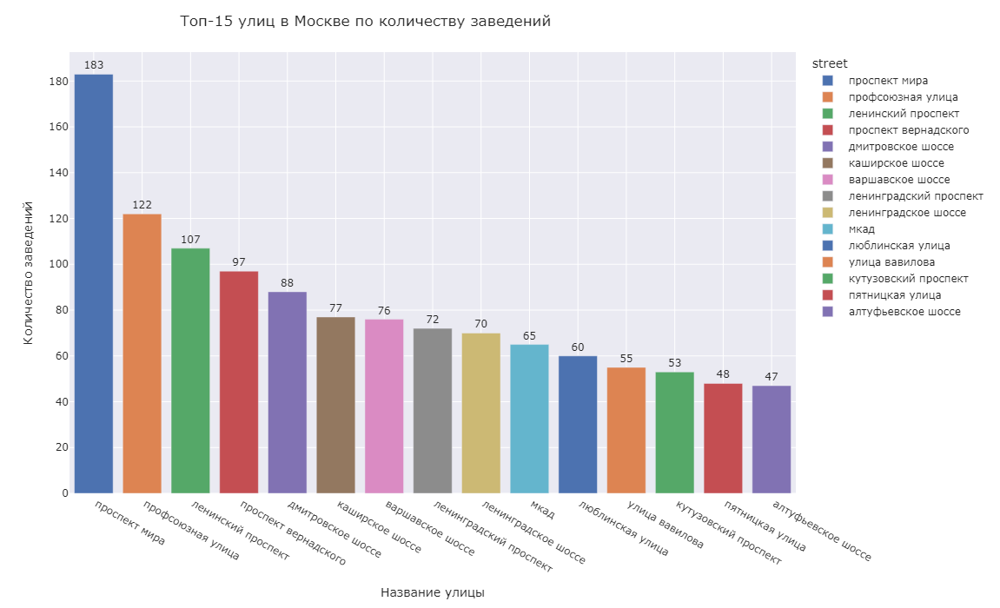

In [43]:
fig = px.bar(data_top_street,
             x='street',
             y='count',
             template='seaborn',                   
             color='street',
             height=700,
             width=900, text_auto=True
                          )
fig.update_traces(textposition = "outside")
fig.update_layout(title = 'Топ-15 улиц в Москве по количеству заведений',
                 title_x=0.18, 
                 xaxis_title = 'Название улицы',
                 yaxis_title = 'Количество заведений')
fig.show()

<div style="background:#AFEEEE; color:#000080; padding:10px">
    
- С большим отрывом в `топ-15` по числу заведений общепита лидирует улица `Проспект Мира - 183 заведения`;
- Чуть меньше заведений на улицах  `Профсоюзная - 122 заведения` и `Ленинский проспект - 107 заведений`;
- Меньше всего заведений в `топ-15` на улицах  `Пятницкая - 48 заведений` и `Алтуфьевское шоссе - 47 заведений`
</div>

<a id="analysis_11"></a>

### Найдем улицы, на которых находится только один объект общепита.

 

In [44]:
data_street = data.pivot_table(index=['street', 'category'],
                               values='name', aggfunc='count')\
                               .sort_values(by='name', ascending=False)\
                               .reset_index()
data.street.value_counts().reset_index()
data_street_one = data.street.value_counts().reset_index()\
                             .query('count == 1')
data_street_one_catering = data_street[data_street['street']\
                          .isin(data_street_one['street'])]
print(f'Количество улиц в г. Москва, на которых находится только один объект общепита: {len(data_street_one_catering)}')


Количество улиц в г. Москва, на которых находится только один объект общепита: 457


**Посмотрим какие категории заведений находятся на этих улицах.**

In [45]:
data_street_one_catering.pivot_table(index='category',
                                     values='name', aggfunc='count')\
                                     .sort_values(by='name', ascending=False)\
                                     .reset_index()\
                                     .style.background_gradient(cmap='coolwarm')

,category,name
0,кафе,159
1,ресторан,93
2,кофейня,84
3,"бар,паб",39
4,столовая,36
5,быстрое питание,23
6,пиццерия,15
7,булочная,8


**Посмотрим как улицы с одним заведением распределены по районам.**

In [46]:
data_street_one_catering_district = data[data['street']\
                           .isin(data_street_one['street'])]

In [47]:
data_district_one = data_street_one_catering_district.pivot_table(index='district', 
                                                                  values='name', 
                                                                  aggfunc='count')\
                                                                  .sort_values(by='name', ascending=False)\
                                                                  .reset_index()
data_district_one

,district,name
0,Центральный административный округ,145
1,Северо-Восточный административный округ,55
2,Восточный административный округ,52
3,Северный административный округ,51
4,Южный административный округ,43
5,Юго-Восточный административный округ,39
6,Западный административный округ,35
7,Северо-Западный административный округ,19
8,Юго-Западный административный округ,18


In [48]:
#data_district_one.name.sum()

In [49]:
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = f.Map(location=[moscow_lat, moscow_lng], zoom_start=8, tiles='CartoDB Positron')
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

marker_cluster = MarkerCluster().add_to(m)

# функция, принимающая строку датафрейма, создает маркер в текущей точке и
# добавляет его в кластер marker_cluster

def create_cluster(row):
    f.Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)
    
# к каждой строке датафрейма применяем функцию
data_street_one_catering_district.apply(create_cluster, axis=1)

state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
f.Choropleth(
    geo_data= state_geo,
    name='choropleth',
    data=data_district_one,
    columns=['district', 'name'],
    key_on='feature.name',
    fill_color='YlGnBu',
    fill_opacity=0.8,
    legend_name='КОЛИЧЕСТВО УЛИЦ С ОДНИМ ОБЪЕКТОМ ОБЩЕПИТА ПО РАЙОНАМ Г. МОСКВА',
).add_to(m)
m


<div style="background:#AFEEEE; color:#000080; padding:10px">
    
- Улиц на которых находится одно заведение общепита оказалось `457 улиц`;
- Больше всего заведений на этих улицах  категории `кафе - 159 заведений`;
- Больше всего улиц с одним заведением общепита располагается в `Центральном административном округе - 145 улиц` меньше всего в `Юго-Западном административном округе - 18 улиц`
</div>

<a id="analysis_12"></a>


### Построим фоновую картограмму (хороплет) с медианными значениями стоимости заказов в рублях для каждого района.

In [50]:
data_district_cheque = data.query('middle_avg_bill != -1')\
                           .pivot_table(index='district', 
                                        values='middle_avg_bill', 
                                        aggfunc='median')\
                           .sort_values(by='middle_avg_bill', ascending=False)\
                           .reset_index()
data_district_cheque.style.background_gradient(cmap='coolwarm')

,district,middle_avg_bill
0,Западный административный округ,1000.000000
1,Центральный административный округ,1000.000000
2,Северо-Западный административный округ,700.000000
3,Северный административный округ,650.000000
4,Юго-Западный административный округ,600.000000
5,Восточный административный округ,550.000000
6,Северо-Восточный административный округ,500.000000
7,Южный административный округ,500.000000
8,Юго-Восточный административный округ,450.000000


In [51]:
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = f.Map(location=[moscow_lat, moscow_lng], zoom_start=8, tiles='CartoDB Positron')
#CartoDB Positron
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
f.Choropleth(
    geo_data= state_geo,
    name='choropleth',
    data=data_district_cheque,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGnBu',
    fill_opacity=0.8,
    legend_name='МЕДИАННОЕ ЗНАЧЕНИЕ СТОИМОСТИ ЗАКАЗОВ В РУБЛЯХ ПО РАЙОНАМ Г. МОСКВА',
).add_to(m)
m

<div style="background:#AFEEEE; color:#000080; padding:10px">
    
- Самый высокая медианная стоимость заказа в `Западном и Центральном административных округах - 1 000 руб.`;
- Самая низкая стоимость заказа `Юго-Восточном административном округе - 450 руб.`;
- Интересная особенность  медианная стоимость заказа в `Западном и Центральном административных округах` выше медианной стоимости заказа в остальных округах на `~ 40-120%`.
</div>

<a id="conclusion_3"></a>
<div style="background:#00FA9A; color:#000080; padding:10px">
  <b>Вывод по разделу №3:</b>
   
***Провели исследовательский анализ заведений общественного питания по различным параметрам.***
    
- Наибольшую долю в общепите г. Москва занимают заведения категории `кафе` - `28.3% или 2 362 ед.`;
- Также в `топ-3` входят заведения категорий `ресторан` - `24.3% или 2 030 ед.` и `кофейня` - `16.8% или 1 401 ед.`;
- Примечательно, что на `топ-3` категорий приходится `69.4%` от общего количества заведений общественного питания;
- По медианному количеству посадочных мест в общепите г. Москва лидирующую позицию занимают заведения категории `ресторан` - `86 мест`;
- Немного уступают ресторанам заведения категорий `бар, паб` - `80 мест` и `кофейня` - `78 мест`;
- Наименьшее число посадочных мест предлагают заведения категории `булочная` - `50 мест`
- Количество `несетевых заведений` общепита г. Москва составляет `61.9%`;
- В основном виден перевес `несетевых заведений` общепита;
- Лишь у 3-х категорий заведений общепита чуть больше `50% сетевых заведений`;
- Категория `пиццерия` соотношение сетевое/несетевое заведение `328 на 301`;
- Категория `кофейня` соотношение сетевое/несетевое заведение `713 на 688`;
- И у категории `булочная` доля сетевых заведений более `60%`- `156 на 99`;
- В `топ-15` `сетевых заведений` общепита вошли `кофейня` и `две пиццерии`;
- Самое большое сетевое заведение `кофейня Шоколадница` - `117 заведений`;
- Больше всего в `топ-15` вошло заведений из категории `кофейня` - `6 сетей`;
- Всего в датасете представлено девять административных округов г. Москва;
- Четверть всех заведений общественного питания г. Москва сосредоточено в Центральном административном округе (ЦАО)  `2 242 заведения`, что неудивительно, так как активная общественная жизнь происходит в центре города;
- Также в ЦАО находится `треть всех ресторанов` столицы;
- Наименьшее количество заведений `875 заведений` находится в Северо-Западном округе г. Москва;
- Наивысший средний рейтинг у категории заведений `бар, паб - 4.39`;
- Наименьший средний рейтинг у категории заведений `быстрое питание - 4.05`;
- Наивысший средний рейтинг у заведений общепита `Центрального административного округа - 4.38`;
- Наименьший средний рейтинг у заведений общепита `Юго-Восточного административного округа - 4.10`;
- С большим отрывом в `топ-15` по числу заведений общепита лидирует улица `Проспект Мира - 183 заведения`;
- Улиц на которых находится одно заведение общепита оказалось `457 улиц`;
- Самый высокая медианная стоимость заказа в `Западном и Центральном административных округах - 1 000 руб.`;
- Самая низкая стоимость заказа `Юго-Восточном административном округе - 450 руб.`.  
</div>

<a id="coffee"></a>


## Проведем детальный анализ на предмет возможного инвестирования в открытие кофейни.

<a id="coffee_1"></a>


### Определим количество кофеен в датасете, в каких районах их больше всего, каковы особенности их расположения.

In [52]:
#data_district_coffee = data.query('middle_avg_bill != -1')\
#                           .pivot_table(index='district', 
#                                        values='middle_avg_bill', 
#                                        aggfunc='count')\
#                           .sort_values(by='middle_avg_bill', ascending=False)\
#                           .reset_index()
#data_district_cheque.style.background_gradient(cmap='coolwarm')
data_coffee = data.query('category == "кофейня"')
data_district_coffee = data_coffee.pivot_table(index='district', columns='category', values='chain', aggfunc='count')\
.reset_index().sort_values(by='кофейня', ascending=False)
display(data_district_coffee.style.background_gradient(cmap='coolwarm'))
print(f'ОБЩЕЕ ЧИСЛО КОФЕЕН  в г. МОСКВА: {data_district_coffee['кофейня'].sum()}')

category,district,кофейня
5,Центральный административный округ,428
2,Северный административный округ,186
3,Северо-Восточный административный округ,159
1,Западный административный округ,146
8,Южный административный округ,131
0,Восточный административный округ,104
7,Юго-Западный административный округ,96
6,Юго-Восточный административный округ,89
4,Северо-Западный административный округ,62


ОБЩЕЕ ЧИСЛО КОФЕЕН  в г. МОСКВА: 1401


In [53]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = f.Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)
place_type = 'Кофейня'
# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    # сохраняем URL-адрес изображения со значком торгового центра с icons8,
    # это путь к файлу на сервере icons8
    icon_url = 'https://img.icons8.com/?size=24&id=PR2pFodk1tI0&format=gif'  
    # создаём объект с собственной иконкой размером 30x30
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    # создаём маркер с иконкой icon и добавляем его в кластер
    f.Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']} {row['district']}",
        tooltip=place_type,
        icon=icon,
    ).add_to(marker_cluster)
# применяем функцию create_clusters() к каждой строке датафрейма
data_coffee.apply(create_clusters, axis=1)    
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
f.Choropleth(
    geo_data= state_geo,
    name='choropleth',
    data=data_district_coffee,
    columns=['district', 'кофейня'],
    key_on='feature.name',
    fill_color='YlOrBr',
    fill_opacity=0.8,
    legend_name='КОЛИЧЕСТВО КОФЕЕН ПО РАЙОНАМ Г. МОСКВА',
).add_to(m)


# выводим карту
m

<div style="background:#AFEEEE; color:#000080; padding:10px">
    
- Самое большое число кофеен в `Центральном административном округе - 428 заведений`;
- Наименьшее число кофеен в `Северо-Западном административном округе - 62 заведения` почти в 7 раз меньше чем в `ЦАО`.

</div>

<a id="coffee_2"></a>


### Определим количество круглосуточных кофеен.

In [54]:
data_coffee_24_7 = data_coffee.query('is_24_7 == True')
data_coffee_24_7_district = data_coffee_24_7.pivot_table(index='district', columns='category', values='chain', aggfunc='count')\
.reset_index().sort_values(by='кофейня', ascending=False)
display(data_coffee_24_7_district.style.background_gradient(cmap='coolwarm'))
print(f'ОБЩЕЕ ЧИСЛО КОФЕЕН С РЕЖИМОМ РАБОТЫ "24/7" в г. МОСКВА: {data_coffee_24_7_district['кофейня'].sum()}')

category,district,кофейня
5,Центральный административный округ,26
1,Западный административный округ,9
7,Юго-Западный административный округ,7
0,Восточный административный округ,5
2,Северный административный округ,5
3,Северо-Восточный административный округ,3
4,Северо-Западный административный округ,2
6,Юго-Восточный административный округ,1
8,Южный административный округ,1


ОБЩЕЕ ЧИСЛО КОФЕЕН С РЕЖИМОМ РАБОТЫ "24/7" в г. МОСКВА: 59


In [55]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = f.Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)
place_type = 'Кофейня 24/7'
# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    # сохраняем URL-адрес изображения со значком торгового центра с icons8,
    # это путь к файлу на сервере icons8
    icon_url = 'https://image.shutterstock.com/image-vector/illustration-isolated-coffee-mug-icon-260nw-447540217.jpg'  
    # создаём объект с собственной иконкой размером 30x30
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    # создаём маркер с иконкой icon и добавляем его в кластер
    f.Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']} {row['district']}",
        tooltip=place_type,
        icon=icon,
    ).add_to(marker_cluster)
# применяем функцию create_clusters() к каждой строке датафрейма
data_coffee_24_7.apply(create_clusters, axis=1)    
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
f.Choropleth(
    geo_data= state_geo,
    name='choropleth',
    data=data_coffee_24_7_district,
    columns=['district', 'кофейня'],
    key_on='feature.name',
    fill_color='YlOrBr',
    fill_opacity=0.8,
    legend_name='ЧИСЛО КОФЕЕН С РЕЖИМОМ РАБОТЫ "24/7" ПО РАЙОНАМ Г. МОСКВА',
).add_to(m)


# выводим карту
m

<div style="background:#AFEEEE; color:#000080; padding:10px">
    
- Ночная жизнь столицы концентрируется в центре, поэтому как и ожидалось самое большое число кофеен формата работы `24/7` находиится в `Центральном административном округе - 26 заведений`;
- Наименьшее число кофеен формата работы `24/7` находится в `Южном и Юго-Восточном административных округах по 1 заведению`.

</div>

<a id="coffee_3"></a>


### Построим фоновую картограмму (хороплет) со средним рейтингом кофеен для каждого района.

In [56]:
#data_coffee_rating = data.query('category == "кофейня"')
data_district_coffee_rating = data_coffee.pivot_table(index='district', columns='category', values='rating', aggfunc='mean')\
.round(2).sort_values(by='кофейня', ascending=False).reset_index()
data_district_coffee_rating.columns = ['district', 'rating']
display(data_district_coffee_rating.style.background_gradient(cmap='coolwarm'))

,district,rating
0,Центральный административный округ,4.340000
1,Северо-Западный административный округ,4.330000
2,Северный административный округ,4.290000
3,Восточный административный округ,4.280000
4,Юго-Западный административный округ,4.280000
5,Юго-Восточный административный округ,4.230000
6,Южный административный округ,4.230000
7,Северо-Восточный административный округ,4.220000
8,Западный административный округ,4.190000


In [57]:
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = f.Map(location=[moscow_lat, moscow_lng], zoom_start=8, tiles='CartoDB Positron')
#CartoDB Positron
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
f.Choropleth(
    geo_data= state_geo,
    name='choropleth',
    data=data_district_coffee_rating,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlOrBr',
    fill_opacity=0.8,
        legend_name='СРЕДНИЙ РЕЙТИНГ КОФЕЕН ПО РАЙОНАМ Г. МОСКВА',
).add_to(m)
m

<div style="background:#AFEEEE; color:#000080; padding:10px">
    
- По среднему рейтингу кофеен лидер вновь `Центральный административный округ - 4.34`;
- Ненамного отстал от `ЦАО` и `Северо-Западный административный округ - 4.33`;
- Самый низкий средний рейтинг кофеен  имеет`Западный административный округ - 4.19`. 

</div>

<a id="coffee_4"></a>


### Построим фоновую картограмму (хороплет) со средней стоимостью чашки капучино для каждого района г. Москва.

In [58]:
data_district_coffee_cup = data_coffee.query('middle_coffee_cup != -1').pivot_table(index='district', values='middle_coffee_cup', aggfunc='mean')\
.round(2).sort_values(by='middle_coffee_cup', ascending=False).reset_index()
display(data_district_coffee_cup.style.background_gradient(cmap='coolwarm'))
print(f'СРЕДНЯЯ СТОИМОСТЬ ЧАШКИ КАПУЧИНО В г. МОСКВА: {round(data_district_coffee_cup['middle_coffee_cup'].mean(), 2)} руб.')

,district,middle_coffee_cup
0,Западный административный округ,188.560000
1,Центральный административный округ,187.520000
2,Юго-Западный административный округ,184.180000
3,Восточный административный округ,174.020000
4,Северный административный округ,166.340000
5,Северо-Западный административный округ,165.520000
6,Северо-Восточный административный округ,165.330000
7,Южный административный округ,158.490000
8,Юго-Восточный административный округ,151.090000


СРЕДНЯЯ СТОИМОСТЬ ЧАШКИ КАПУЧИНО В г. МОСКВА: 171.23 руб.


In [59]:
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = f.Map(location=[moscow_lat, moscow_lng], zoom_start=8, tiles='CartoDB Positron')
#CartoDB Positron
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
f.Choropleth(
    geo_data= state_geo,
    name='choropleth',
    data=data_district_coffee_cup,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='YlOrBr',
    fill_opacity=0.8,
    legend_name='СРЕДНЯЯ СТОИМОСТЬ ЧАШКИ КАПУЧИНО ПО РАЙОНАМ Г. МОСКВА',
).add_to(m)
m

<div style="background:#AFEEEE; color:#000080; padding:10px">
    
- А вот здесь получилось интересно округ с самым низким рейтингом кофеен имеет самую высокую среднюю стоимость чашшки капучино `Западный административный округ - 188.56 руб.`;
- Средняя стоимость чашки капучино в `Центральном административном округе - 187.52 руб.`;
- Самый низкая средняя стоимость чашки капучино в `Юго-Восточном административном округе - 151.09 руб.`. 

</div>

<a id="conclusion_4"></a>
<div style="background:#00FA9A; color:#000080; padding:10px">
  <b>Вывод по разделу №4:</b>
   
***Провели детальный анализ заведений общественного питания по категории `кофейня`.***

- Самое большое число кофеен в `Центральном административном округе - 428 заведений`;
- Наименьшее число кофеен в `Северо-Западном административном округе - 62 заведения` почти в 7 раз меньше чем в `ЦАО;    
- Ночная жизнь столицы концентрируется в центре, поэтому как и ожидалось самое большое число кофеен формата работы `24/7` находиится в `Центральном административном округе - 26 заведений`;
- Наименьшее число кофеен формата работы `24/7` находится в `Южном и Юго-Восточном административных округах по 1 заведению`
- По среднему рейтингу кофеен лидер вновь `Центральный административный округ - 4.34`;
- Ненамного отстал от `ЦАО` и `Северо-Западный административный округ - 4.33`;
- Самый низкий средний рейтинг кофеен  имеет`Западный административный округ - 4.19`;
- А вот здесь получилось интересно округ с самым низким рейтингом кофеен имеет самую высокую среднюю стоимость чашки капучино `Западный административный округ - 188.56 руб.`;
- Средняя стоимость чашки капучино в `Центральном административном округе - 187.52 руб.`;
- Самый низкая средняя стоимость чашки капучино в `Юго-Восточном административном округе - 151.09 руб.`.
</div>

<a id="the_final"></a>


## РЕКОМЕНДАЦИИ.

<a id="recommendation"></a>
<div style="background:#00FA9A; color:#000080; padding:10px">
  <b>РЕКОМЕНДАЦИЯ</b>
   
***Инвестирование в открытие `кофейни`.***

Выход на рынок кофеен довольно-таки рискован. Факт: в ТОП-15 популярных сетей входит `6 сетевых кофеен`. Самая крупная сеть общепита - это `кофейня "Шоколадница"`.

Я бы рекомендовал не рассматривать открытие кофейни в следующих локациях:

- Центральный административный округ из-за насыщенности заведений подобного типа и соответственно очень высокой конкуренции

- На улицах из ТОП-3 по количеству заведений по причинам, озвученным выше

- На улицах с одним объектом общепита, что свидетельствует о об отсутствии большого потока потенциальных клиентов

Режим работы кофейни, если она не располагается в Центральном административном округе не должен быть круглосуточным.

Открытие кофейни я бы предложил рассмотреть в `Западном административном округе`. Ввиду низких рейтингов кофеен и высокой средней стоимости чашки капучино можно привлечь потенциальных клиентов качественным обслуживанием и стоимостью чашки капучино на уровне медианнного значения по г. Москва `174.72 руб`. 

Кстати, средняя стоимость заказа в `Западном административном округе` одна из самых высоких в г. Москва, что говорит о платёжеспособности потенциальных клиентов и дает уверенность в правильности выбора места открытия кофейни.
</div>

Презентация: https://disk.yandex.ru/i/9BLvOarOGxva6A
